# Task description

To create concept-art for game charachter based on the references below using Diffusion Models.

Charachter visual reference:
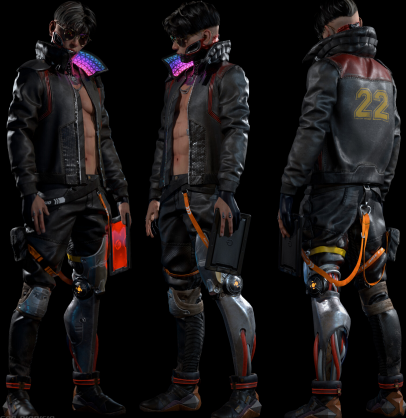

Stylistic reference:
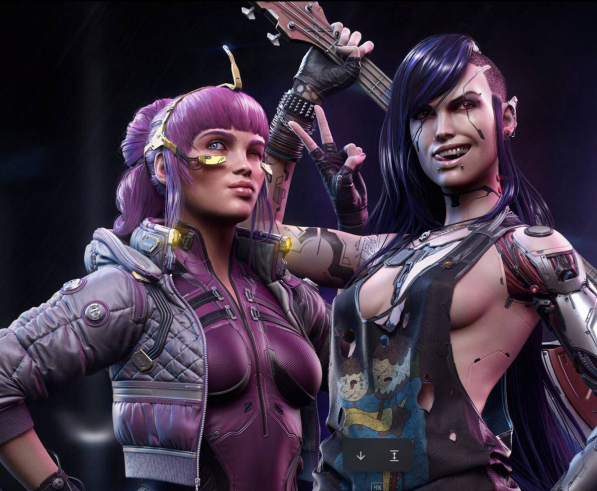

Color refrence:
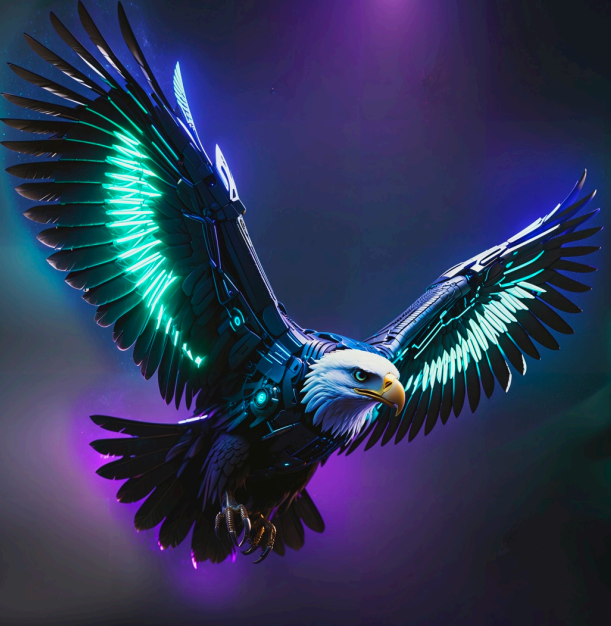


# Solution

Use prompts for Diffusion 3 to create charachter sheet.
Chosen model **stable-diffusion-3-medium-diffusers** open source from hugging face [(link)](https://huggingface.co/stabilityai/stable-diffusion-3-medium-diffusers) as part of the diffusers library. Stable Diffusion 3 Medium is a Multimodal Diffusion Transformer (MMDiT) text-to-image model.

For each prompt I will generate 2 series of images with different number of steps. I will take only 350 and 450 steps for each image (app 1 min), I will not utilize any special setting and will use only default ones for generation.

In [2]:
import torch
from diffusers import StableDiffusion3Pipeline
pipeline = StableDiffusion3Pipeline.from_pretrained(
    "stabilityai/stable-diffusion-3-medium-diffusers", torch_dtype=torch.float16)

device = "cuda" if torch.cuda.is_available() else "cpu"
pipeline.to(device)

/home/jupyter/.local/lib/python3.10/site-packages/transformers/utils/hub.py:127: FutureWarning: Using `TRANSFORMERS_CACHE` is deprecated and will be removed in v5 of Transformers. Use `HF_HOME` instead.
  warnings.warn(
2024-07-19 20:40:47.685081: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-19 20:40:50.967429: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Loading pipeline components...: 100%|██████████| 9/9 [00:11<00:00,  1.28s/it]


StableDiffusion3Pipeline {
  "_class_name": "StableDiffusion3Pipeline",
  "_diffusers_version": "0.29.2",
  "_name_or_path": "stabilityai/stable-diffusion-3-medium-diffusers",
  "scheduler": [
    "diffusers",
    "FlowMatchEulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "text_encoder_3": [
    "transformers",
    "T5EncoderModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_3": [
    "transformers",
    "T5TokenizerFast"
  ],
  "transformer": [
    "diffusers",
    "SD3Transformer2DModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [14]:
# ф-ция для вывода сгенерированных картинок

from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

def gen_images():   
    all_images = [pipeline(prompt, num_inference_steps = i,negative_prompt="").images[0] for i in range(250, 450, 100)]
    grid = image_grid(all_images, rows = 2, cols = 1)
    return grid

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


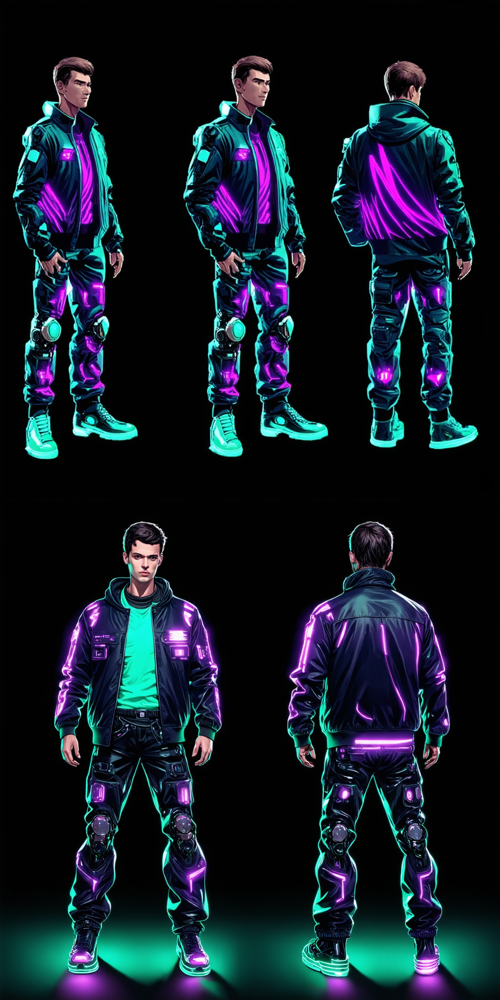

In [15]:
prompt = ["graphic photorealis, character sheet, cyborg 60% human, computer genius and hacker, young, wearing jacket and trousers in cyberpunk style with violet and green neon lights and standing at full-body, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right side"]
gen_images()


100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


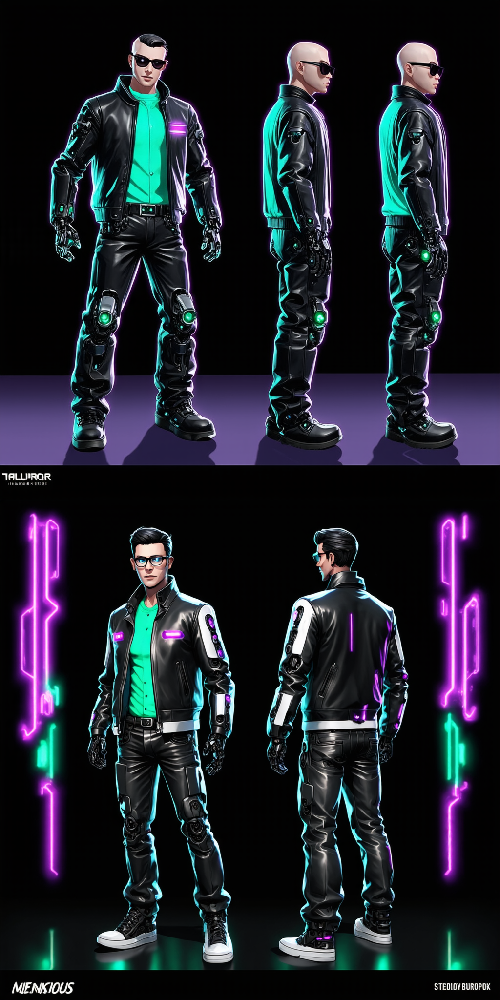

In [16]:
prompt = ["photorealistic character sheet, rebellious computer genius and hacker, human with robotics enhancements, wearing glasses, leather jacket and trousers in cyberpunk style with emerald and violet neon lights, standing at full-body length, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right side"]
gen_images()

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


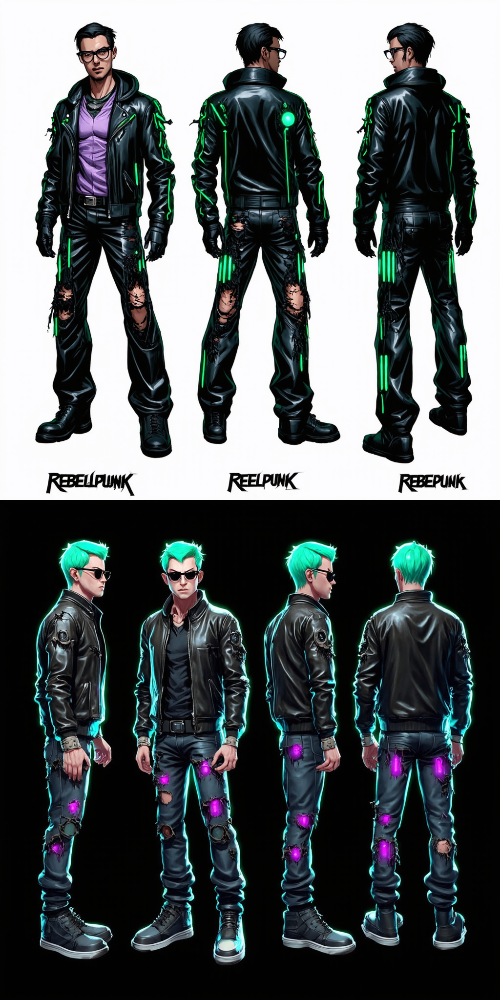

In [17]:
prompt = ["photorealistic character sheet, rebellious computer cyborg genius from post-apocalyptic underground, wearing glasses, tattered leather jacket and trousers in cyberpunk style with emerald and violet neon lights;standing at full-body length, black background; image split into 4 pictures, shot from 4 different angles: front, back, left and right side"]
gen_images()

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


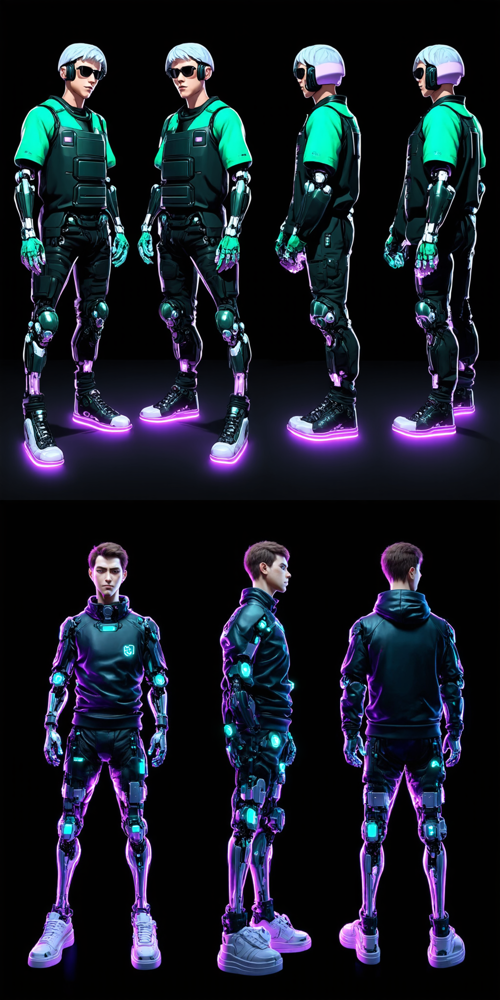

In [18]:
prompt = ["photorealistic, futuristic, character sheet, cyborg 60% human, computer genius and hacker, young, cyberpunk techwear streetwear look and clothes with violet and green neon lights, and standing at full-body, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right"]
gen_images()

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


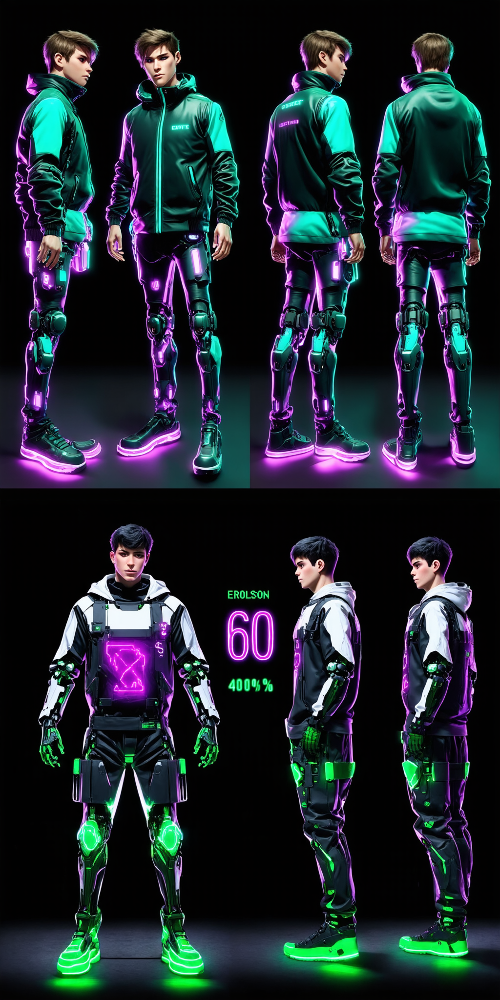

In [19]:
prompt = ["graphic and photorealistic, character sheet, cyborg 60% human, techwear fashion, Errolson Hugh, young, cyberpunk techwear streetwear look and clothes with violet and green neon lights, and standing at full-body, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right"]
gen_images()

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


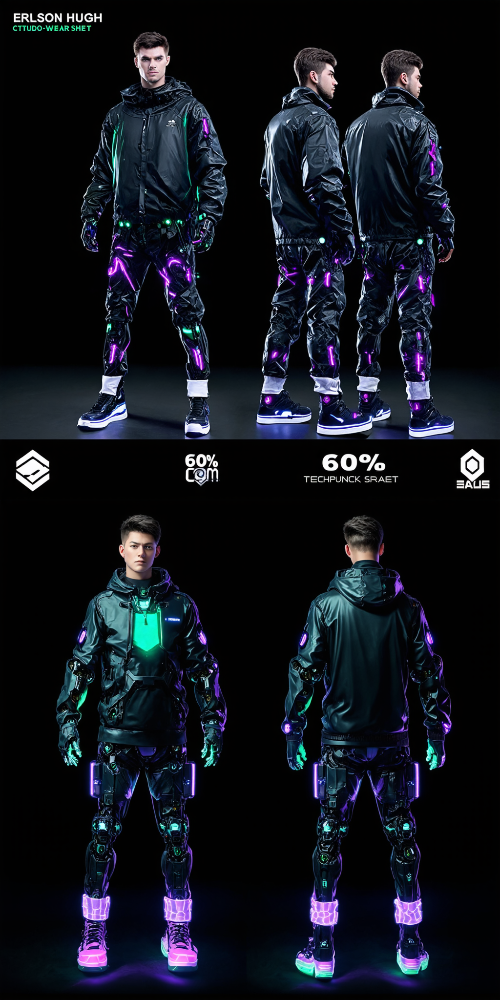

In [23]:
prompt = ["photorealistic, character sheet, cyborg 60% human, techwear fashion, Errolson Hugh, young, cyberpunk techwear streetwear look and clothes with violet and green neon lights, and standing at full-body, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right"]
gen_images()

100%|██████████| 350/350 [01:01<00:00,  5.65it/s]


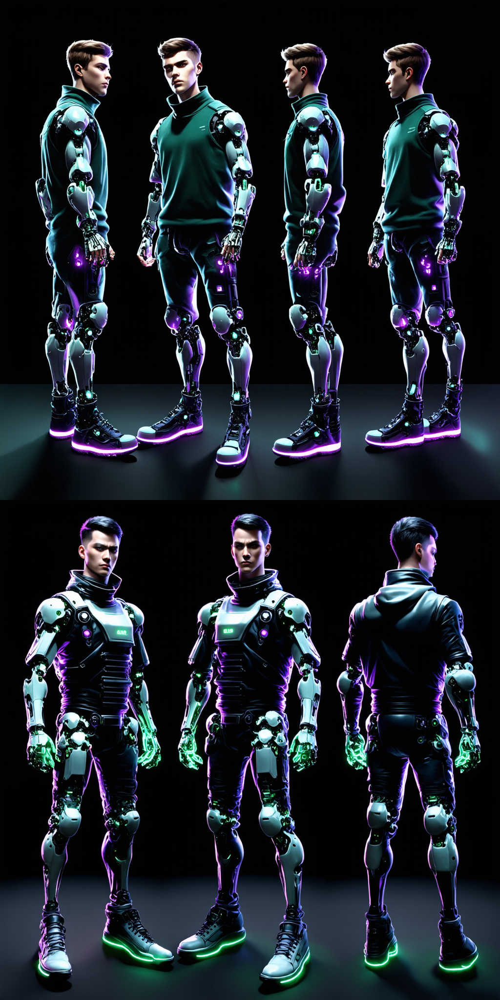

In [22]:
prompt = ["sci-fi photorealistic character sheet, cyborg 60% human, techwear fashion, Errolson Hugh, young, cyberpunk techwear streetwear look and clothes with violet and green neon lights, and standing at full-body, studio setting, black background; image split into 4 different pictures, shot from 4 different angles: front, back, left and right"]
gen_images()

# Comments

Model is very sensitive to prompt and thus charachter designes are changing depending of the words used.
Achieved:

- keeping the color scheme in majority of generations
- keeping the stulistic references (in some of the generations)
- keeping the ccharacter visuals (50/50)

Not achieved:
- include all 4 positions for character sheet (some generations include the same poses or only 2)
- artifacts are sometimes generated (like additional hands, fingers and feet)

As next step makes sense to try textual inversion on the charachter reference (if I have time)